In [1]:
# Install flory
!pip install flory

import numpy as np
DTYPE = np.float64
import flory
import matplotlib.pyplot as plt
# %matplotlib notebook
# %matplotlib widget
import os
import sys
import pandas as pd
from tqdm import tqdm
import plotly.graph_objects as go


In [2]:
def floryHuggins(phi:DTYPE, chi:np.array):
    part_1 = np.sum(phi*np.log(phi))
    part_2 = 0

    for i in range(len(phi)):
        for j in range(i+1, len(phi)):
            part_2 += chi[i][j]*phi[i]*phi[j]

    return part_1 + part_2

In [3]:
# Interaction matrix
chis = np.array([[0, 3.0, 3.0], [3.0, 0.0, 3.0], [3.0, 3.0, 0.0]], dtype = DTYPE)

# Global value of phis
phi_global = np.array([0.4, 0.3, 0.3], dtype = DTYPE)

# Equilibrium 3 phase solution
phases = flory.find_coexisting_phases(3, chis, phi_global, progress=False)

print("\n" + f"Equlibrium phase volumes: {phases.volumes}")
print("Equlibrium phase concentrations:\n" + f"{phases.fractions}")

# Take the transpose as the notation is different:
# For me: phi_ij = component i in compartment j
# For flory: phi_ji = component i in compartment j (OR I THINK SO!)

phases.fractions = np.transpose(phases.fractions)


Equlibrium phase volumes: [0.4263908  0.28680676 0.28680244]
Equlibrium phase concentrations:
[[0.81092088 0.09453904 0.09454003]
 [0.09454434 0.81091191 0.09454381]
 [0.09454187 0.09454035 0.81091778]]


In [4]:
phases.fractions

array([[0.81092088, 0.09454434, 0.09454187],
       [0.09453904, 0.81091191, 0.09454035],
       [0.09454003, 0.09454381, 0.81091778]])

In [5]:
# Free energy of the 3 phase system

F_flory = 0
for i in range(len(phases.volumes)):
    F_flory += phases.volumes[i]*floryHuggins(phases.fractions[:, i], chis)

print(F_flory)


-0.12914677534980099


In [6]:
# Merging compartments 1 and 2

# First, calculate the modified compositions in the hybrid compartment (1+2)
eta_mod = phases.volumes[0] + phases.volumes[1]
phi_1mod = (phases.volumes[0]*phases.fractions[0, 0] + phases.volumes[1]*phases.fractions[0, 1])/eta_mod
phi_2mod = (phases.volumes[0]*phases.fractions[1, 0] + phases.volumes[1]*phases.fractions[1, 1])/eta_mod
phi_3mod = 1 - phi_1mod - phi_2mod

# So, now we have two phases with [phi_1mod, phi_2mod, phi_3mod] and [phases.fractions[0, 2], phases.fractions[1, 2], phases.fractions[2, 2]]
# with volumes (phases.volumes[0] + phases.volumes[1]) and phases.volumes[2] respectively

# For perturbations, we keep the volumes of these individual phases fixed
# Essentially, only perturb the concentrations

phi_in_kmod = [phi_1mod, phi_2mod, phi_3mod]
phi_in_k3 = [phases.fractions[0, 2], phases.fractions[1, 2], phases.fractions[2, 2]]

# Calculate the Free Energy of this modified system
# i.e. Free Energy of the proposal

F_mod = eta_mod*floryHuggins(phi_in_kmod, chis) + phases.volumes[2]*floryHuggins(phi_in_k3, chis)
print(F_mod)

-0.08887508634841289


In [7]:
eta_mod

0.7131975648068226

In [8]:
0.7131930326092074


0.7131930326092074

In [9]:
phi_1mod, phi_2mod

(0.5228357201730037, 0.38262272902547523)

In [10]:
# Effectively 2 degrees of freedom in the system
step_size = DTYPE(0.001)
n_points = 1000

phi_1mod_perturbed = np.linspace(phi_1mod-n_points*step_size, phi_1mod+n_points*step_size, 2*n_points+1)
phi_2mod_perturbed = np.linspace(phi_2mod-n_points*step_size, phi_2mod+n_points*step_size, 2*n_points+1)

accepted_phi_1mod_perturbed = []
accepted_phi_2mod_perturbed = []
accepted_Fs_mod = []

In [11]:
phi_1mod, phi_2mod

(0.5228357201730037, 0.38262272902547523)

In [12]:
np.min(phi_1mod_perturbed), np.max(phi_1mod_perturbed)

(-0.4771642798269963, 1.5228357201730036)

In [13]:
ctr = 0

for phi_1m in phi_1mod_perturbed:
    for phi_2m in phi_2mod_perturbed:
        if phi_1m<0 or phi_2m<0 or phi_1m>1 or phi_2m>1:
            continue
        
        phi_3m = 1 - phi_1m - phi_2m
        if phi_3m<0 or phi_3m>1:
            continue

        # Calculate the concentrations in the 3rd compartment
        phi_13mod = (phi_global[0] - phi_1m*(eta_mod))/(phases.volumes[2])
        phi_23mod = (phi_global[1] - phi_2m*(eta_mod))/(phases.volumes[2])
       
        if phi_13mod<0 or phi_13mod>1 or phi_23mod<0 or phi_23mod>1:
            continue
        
        phi_33mod = 1 - phi_13mod - phi_23mod
        if phi_33mod<0 or phi_33mod>1:
            continue

        ctr += 1

        phi_in_kmod = [phi_1m, phi_2m, phi_3m]
        phi_in_k3 = [phi_13mod, phi_23mod, phi_33mod]
        
        F = 0
        F = eta_mod*floryHuggins(phi_in_kmod, chis) + phases.volumes[2]*floryHuggins(phi_in_k3, chis)

        accepted_phi_1mod_perturbed.append(phi_1m)
        accepted_phi_2mod_perturbed.append(phi_2m)
        accepted_Fs_mod.append(F)

In [14]:
ctr/len(phi_1mod_perturbed)**2

0.020331163753455606

In [15]:
df = pd.DataFrame()
df["phi_1mod"] = accepted_phi_1mod_perturbed
df["phi_2mod"] = accepted_phi_2mod_perturbed
df["F"] = accepted_Fs_mod

df

,phi_1mod,phi_2mod,F
0,0.158836,0.420623,-0.064235
1,0.159836,0.419623,-0.067160
2,0.159836,0.420623,-0.066987
3,0.160836,0.418623,-0.069158
4,0.160836,0.419623,-0.069913
...,...,...,...
81401,0.560836,0.416623,-0.013028
81402,0.560836,0.417623,-0.010502
81403,0.560836,0.418623,-0.007714
81404,0.560836,0.419623,-0.004533


In [16]:
min_F_row = df[df['F'] == df['F'].min()]
min_F_row

,phi_1mod,phi_2mod,F
3612,0.242836,0.378623,-0.106526


In [17]:
min_F_row["phi_1mod"].values[0], min_F_row["phi_2mod"].values[0]

(0.2428357201730037, 0.3786227290254752)

In [18]:
phi_1mod, phi_2mod

(0.5228357201730037, 0.38262272902547523)

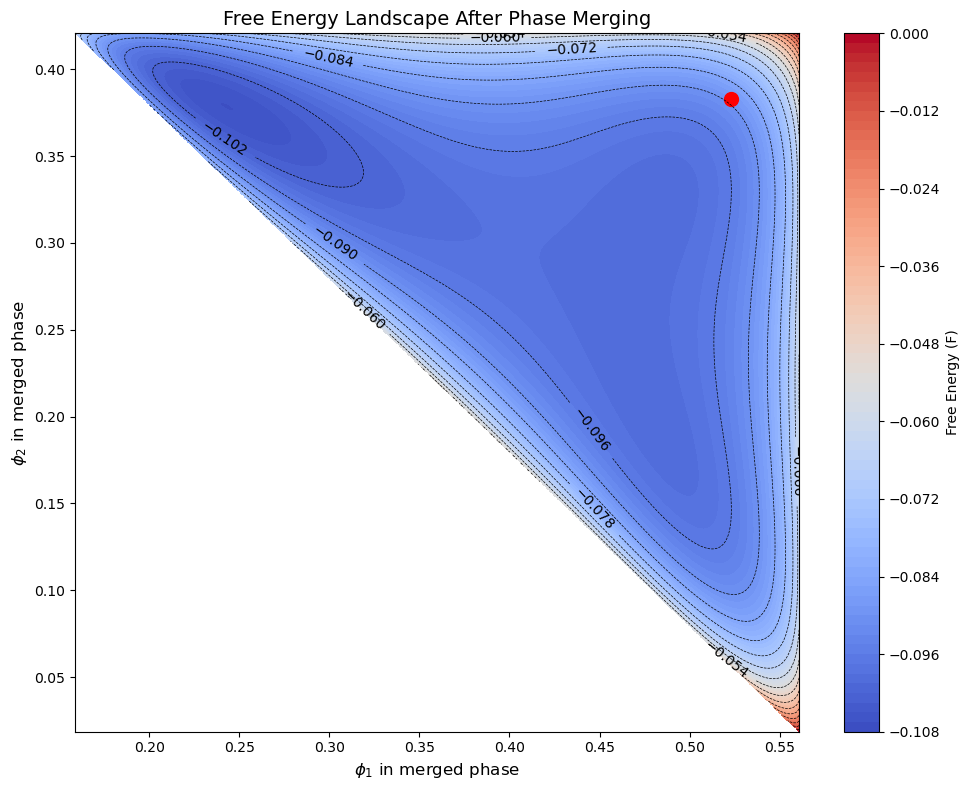

In [21]:
from scipy.interpolate import griddata
phi1_grid = np.linspace(min(df["phi_1mod"]), max(df["phi_1mod"]), 1000)
phi2_grid = np.linspace(min(df["phi_2mod"]), max(df["phi_2mod"]), 1000)
phi1_mesh, phi2_mesh = np.meshgrid(phi1_grid, phi2_grid)

# Interpolate F values onto the grid
F_grid = griddata(
    (df["phi_1mod"], df["phi_2mod"]), 
    df["F"], 
    (phi1_mesh, phi2_mesh), 
    method='cubic'
)
# [Previous code remains the same until the plotting section]

# Create the contour plot
plt.figure(figsize=(10, 8))
contour = plt.contourf(phi1_mesh, phi2_mesh, F_grid, levels=70, cmap = "coolwarm")
plt.colorbar(contour, label='Free Energy (F)')

# Find the minimum free energy point
min_F_index = np.argmin(df["F"])
min_phi1 = df["phi_1mod"].iloc[min_F_index]
min_phi2 = df["phi_2mod"].iloc[min_F_index]
min_F = df["F"].iloc[min_F_index]

# Mark the original point
plt.scatter(
    phi_1mod, phi_2mod, 
    color='red', 
    s=100, 
    label='Original Composition'
)

# # Mark the minimum free energy point
# plt.scatter(
#     min_phi1, min_phi2, 
#     color='yellow', 
#     s=100, 
#     marker='*',
#     edgecolor='black',
#     linewidth=0.5,
#     label=f'Minimum F ({min_F:.4f})'
# )

# Add contour lines
CS = plt.contour(phi1_mesh, phi2_mesh, F_grid, levels=20, colors='k', linewidths=0.5)
plt.clabel(CS, inline=True, fontsize=10)

plt.xlabel(r'$\phi_1$ in merged phase', fontsize=12)
plt.ylabel(r'$\phi_2$ in merged phase', fontsize=12)
plt.title('Free Energy Landscape After Phase Merging', fontsize=14)
plt.tight_layout()
plt.show()

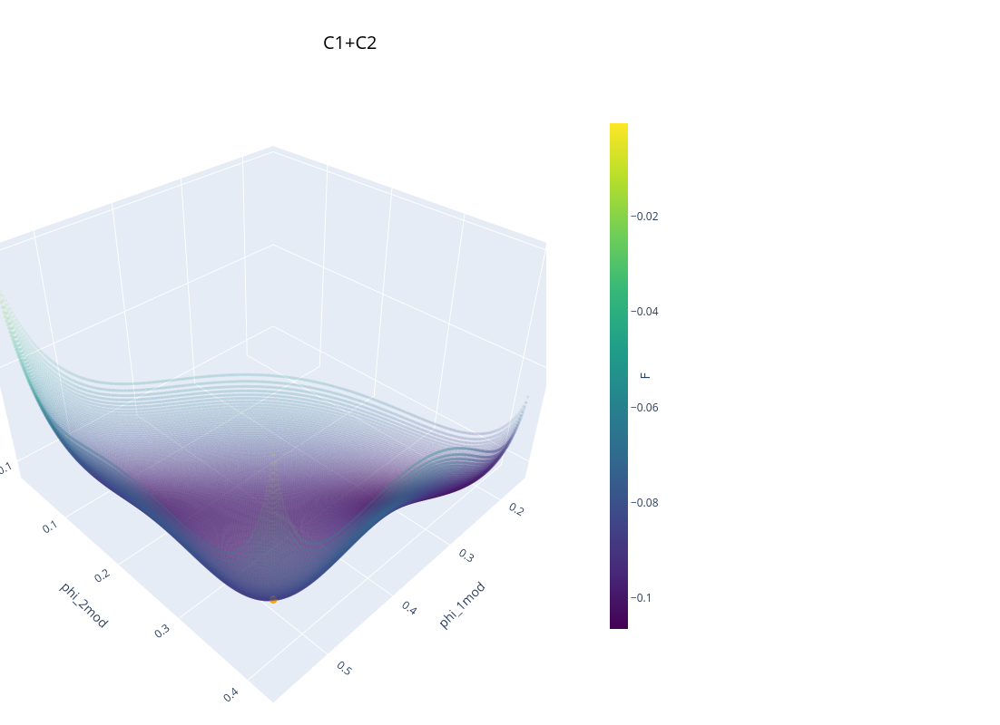

In [16]:
fig = go.Figure()

fig.add_trace(go.Scatter3d(
    x=pd.Series(df["phi_1mod"].values.ravel()),
    y=pd.Series(df["phi_2mod"].values.ravel()),
    z=pd.Series(df["F"].values.ravel()),
    mode='markers',
    marker=dict(
        size=2,
        color=pd.Series(df["F"].values.ravel()),  # Color by F values
        colorscale='Viridis',
        opacity = 0.1,
        colorbar=dict(
            title='F',  # Colorbar title
            titleside='right',
            titlefont=dict(size=14),
            thickness=20,
            len=0.75,
            x=1.1  # Position adjustment
        ),
        cmin=df["F"].min(),  # Set color scale range
        cmax=df["F"].max()
    ),
    showlegend=False  # Add this to each trace

))

fig.add_trace(go.Scatter3d(
    x=pd.Series(phi_1mod.ravel()),
    y=pd.Series(phi_2mod.ravel()),
    z=pd.Series(F_mod.ravel()),
    mode='markers',
    marker=dict(
        size=5,
        color='orange',
        symbol='circle'
    ),
    showlegend=False  # Add this to each trace
))

fig.update_layout(
    title={
    'text': "C1+C2",  # Title text
    'y':0.95,  # Position from top (0-1)
    'x':0.35,   # Center the title
    'xanchor': 'center',
    'yanchor': 'top',
    'font': dict(
        size=20,  # Title font size
        color='black'  # Title color
    )
    },

    width=1200,  # Width in pixels
    height=800,   # Height in pixels
    autosize=False,  # Disable autosizing
    scene=dict(
        xaxis_title='phi_1mod',
        yaxis_title='phi_2mod',
        zaxis_title='F_sys',
        aspectmode='manual',  # Preserve aspect ratio
        aspectratio=dict(x=1, y=1, z=0.7)  # Adjust these values as needed
    ),
    margin=dict(l=0, r=500, b=0, t=30)  # Increased right margin for colorbar
)

fig.show()